# start

In [7]:
PRFX = 'MelEda0627A1'
PRFX_PREP = 'MelPrp0626A2'

# setup

In [43]:
from pathlib import Path
import pickle
import pandas as pd
import random
import os
import numpy as np
import matplotlib.pyplot as plt

from collections import defaultdict, Counter

# eda

In [24]:
p_cmp = '../input/siim-isic-melanoma-classification/'
p_prp = f'../output/{PRFX_PREP}'
dftrn = pd.read_csv(f'{p_prp}/train_all.csv') 
dftst = pd.read_csv(f'{p_cmp}/test.csv')

In [10]:
dftrn.shape

(58457, 4)

In [25]:
dftst.shape

(10982, 5)

In [11]:
dftrn.head()

,source,im_pth,patient_id,target
0,20,../input/siim-isic-melanoma-classification/jpe...,IP_7279968,0.0
1,20,../input/siim-isic-melanoma-classification/jpe...,IP_3075186,0.0
2,20,../input/siim-isic-melanoma-classification/jpe...,IP_2842074,0.0
3,20,../input/siim-isic-melanoma-classification/jpe...,IP_6890425,0.0
4,20,../input/siim-isic-melanoma-classification/jpe...,IP_8723313,0.0


In [26]:
dftst.head()

,image_name,patient_id,sex,age_approx,anatom_site_general_challenge
0,ISIC_0052060,IP_3579794,male,70.0,NaN
1,ISIC_0052349,IP_7782715,male,40.0,lower extremity
2,ISIC_0058510,IP_7960270,female,55.0,torso
3,ISIC_0073313,IP_6375035,female,50.0,torso
4,ISIC_0073502,IP_0589375,female,45.0,lower extremity


## train set imgs

In [34]:
idx_nopid=np.where(dftrn.patient_id.isna())[0]
print(len(idx_nopid))
dftrn['patient_id'].iloc[idx_nopid]=[f'Nan_{i}' for i in range(len(idx_nopid))]
assert dftrn.patient_id.isna().mean()==0

0


- A part of the training dataset is the HAM10 0 0 0 dataset which contains images of size 600 ×450 that were centered and cropped around the lesion. 
- The dataset curators applied histogram corrections to some images [1] . 
- Another dataset, BCN_20 0 0 0, contains images of size 1024 ×1024. This dataset is particularly challenging as many images are uncropped and lesions in difficult and uncommon locations are present [2] . 
- Last, the MSK dataset contains images with various sizes.

In [35]:
dftrn['ds']=dftrn.patient_id.apply(lambda x: x.split('_')[0])
dftrn.ds.value_counts()

IP      33126
BCN     12413
HAM     10015
Nan      2084
MSK4      819
Name: ds, dtype: int64

In [37]:
dftrn.sample()

,source,im_pth,patient_id,target,ds
51787,19,../input/andrewmvd--isic-2019/ISIC_2019_Traini...,BCN_0002603,0.0,BCN


In [38]:
dftrn.groupby('ds').target.mean()

ds
BCN     0.230162
HAM     0.111133
IP      0.017630
MSK4    0.262515
Nan     0.161708
Name: target, dtype: float64

IP


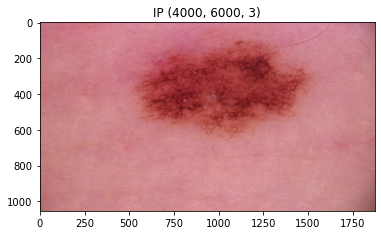

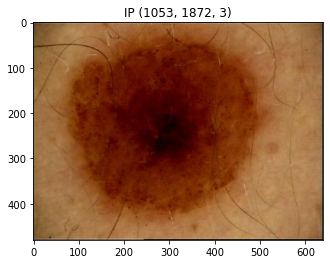

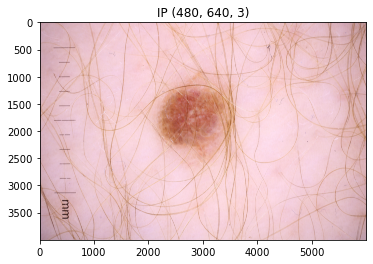

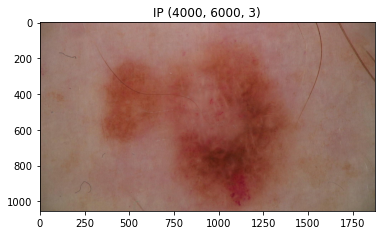

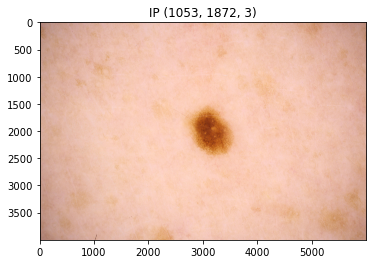

...

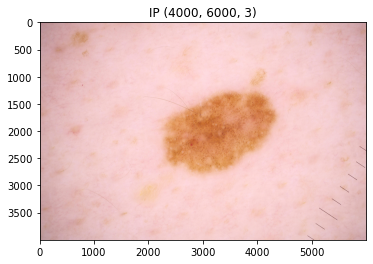

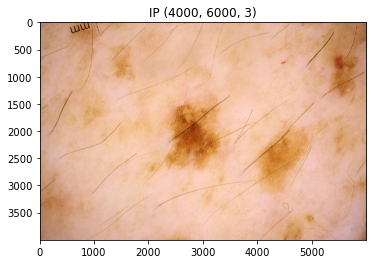

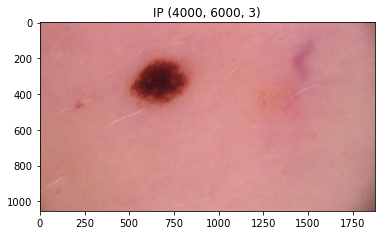

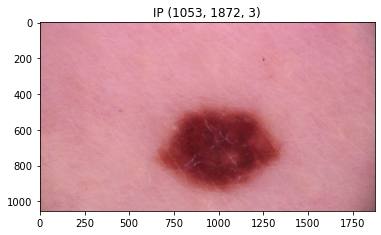

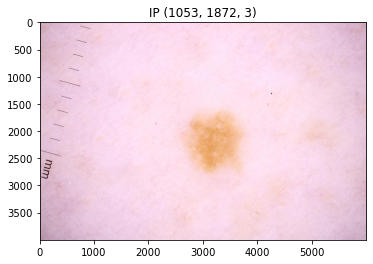

**************************************************
Nan


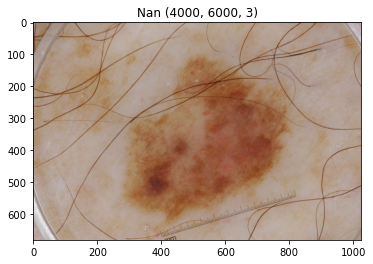

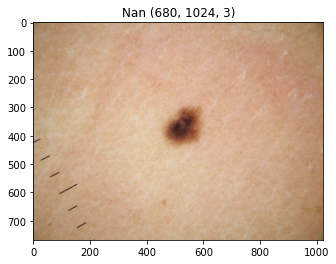

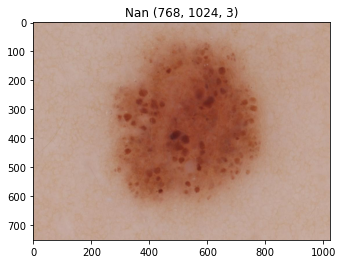

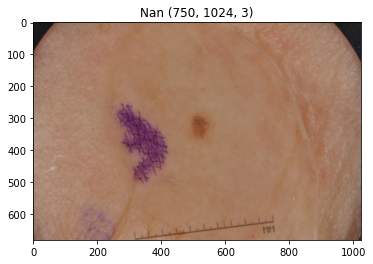

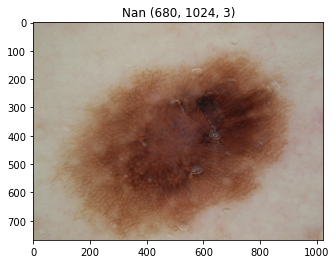

...

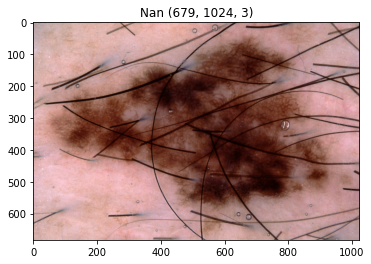

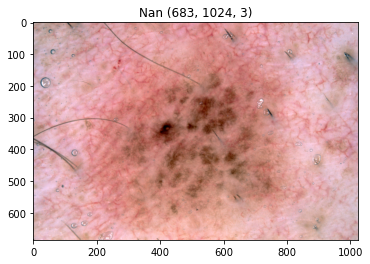

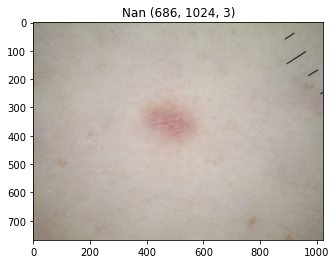

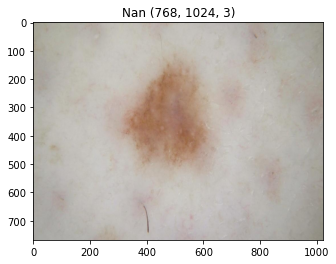

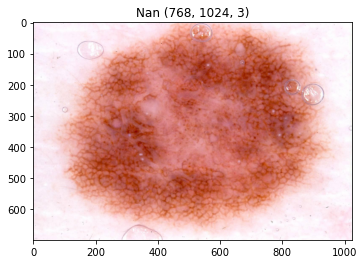

**************************************************
MSK4


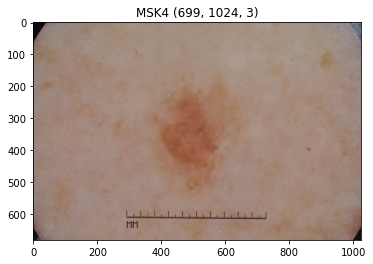

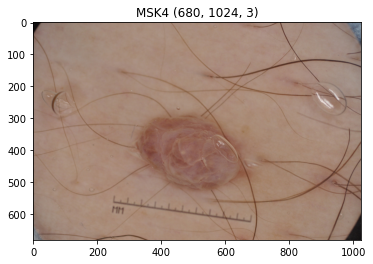

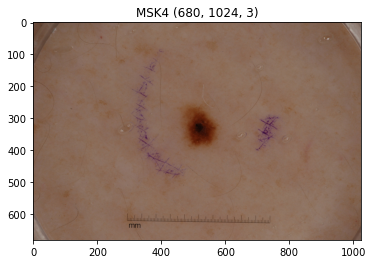

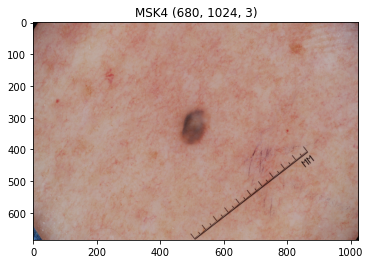

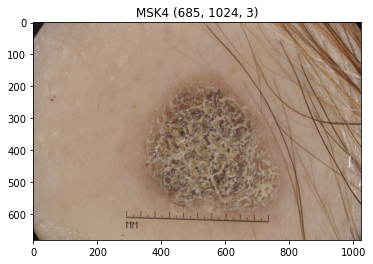

...

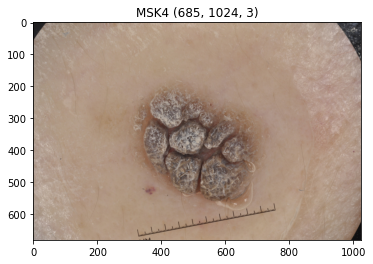

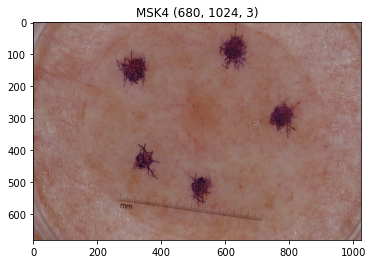

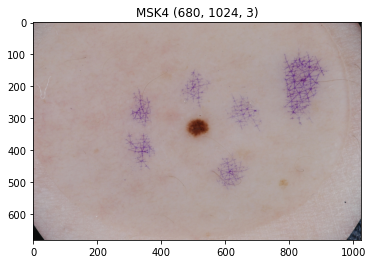

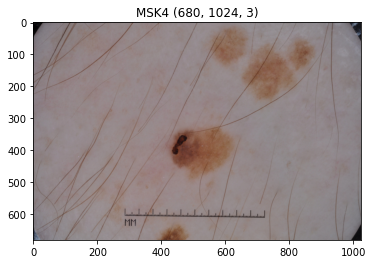

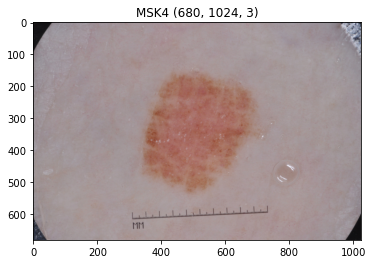

**************************************************
HAM


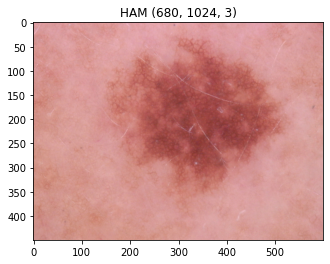

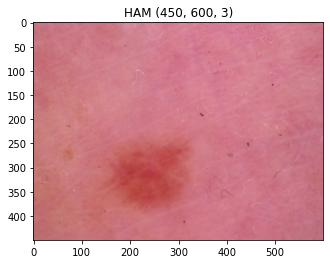

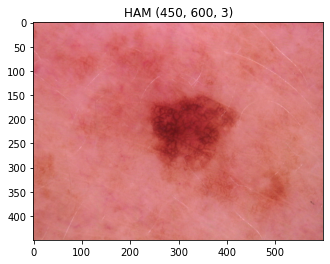

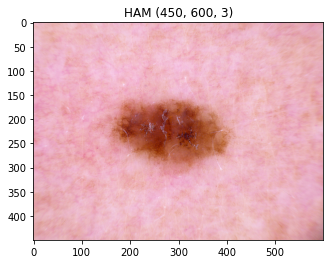

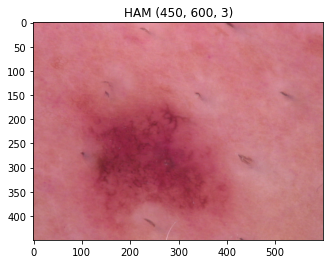

...

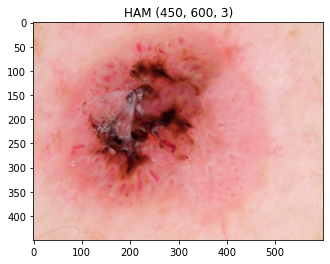

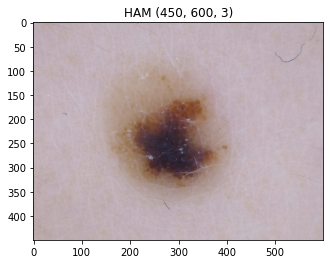

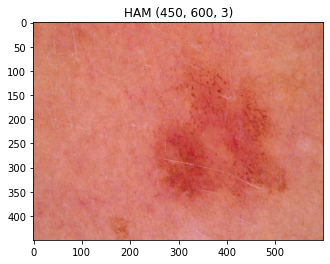

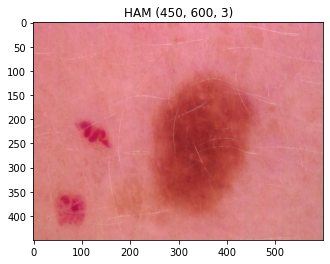

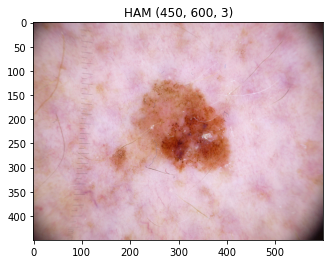

**************************************************
BCN


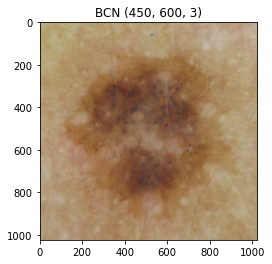

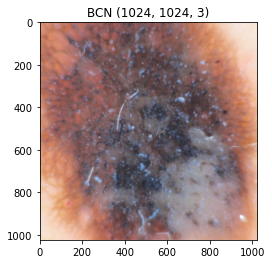

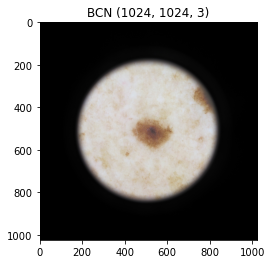

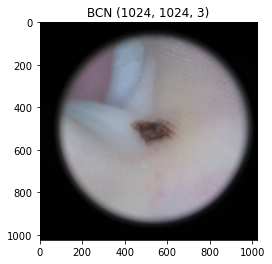

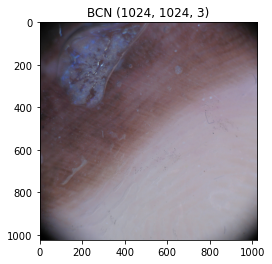

...

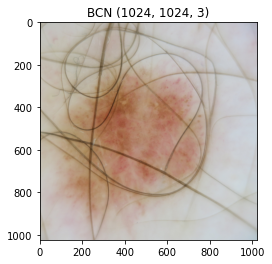

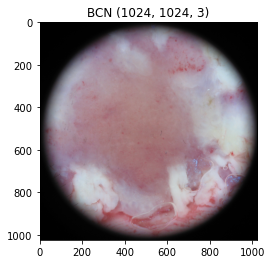

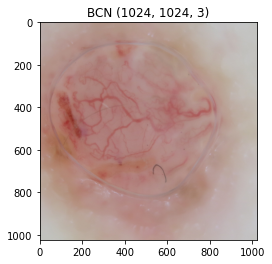

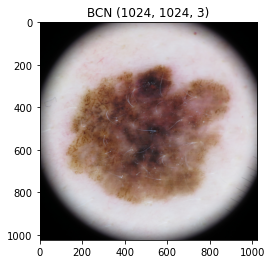

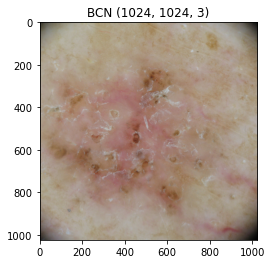

**************************************************


In [55]:
dss = dftrn.ds.unique()

for ds in dss:
    print(ds)
    fnms = np.random.choice(dftrn[dftrn.ds==ds].im_pth, 20, replace=False)
    for fnm in fnms:
        plt.title(f'{ds} {img.shape}')
        img = plt.imread(fnm)
        plt.imshow(img)
        plt.show()
    print('*'*50)

## test set imgs

In [59]:
dftst['im_pth']=f'{p_cmp}/jpeg/test/'+dftst.image_name+'.jpg'

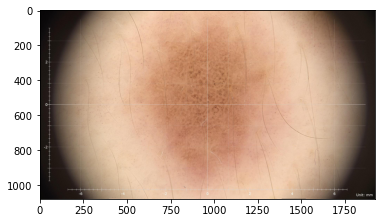

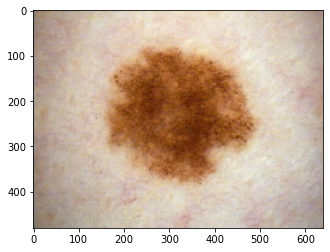

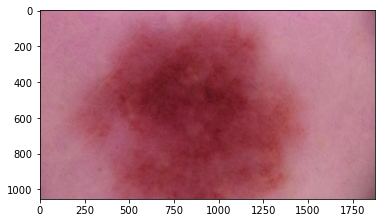

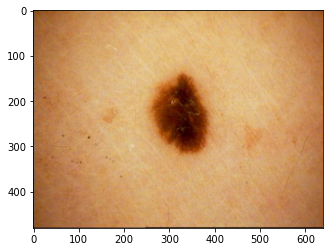

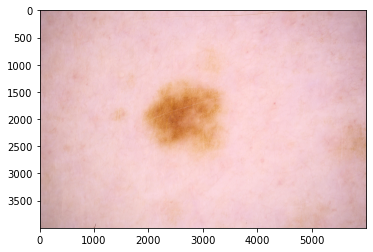

...

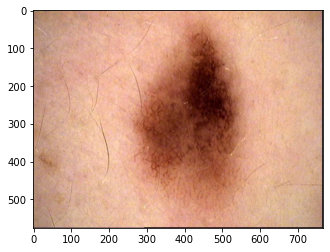

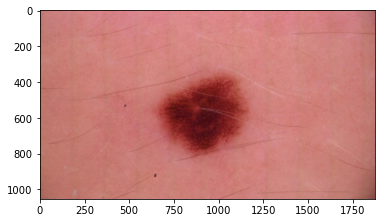

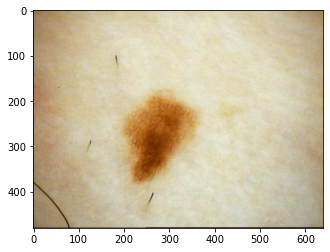

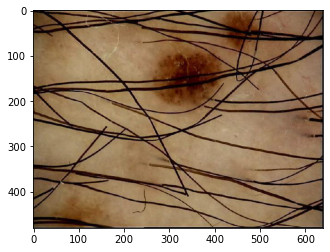

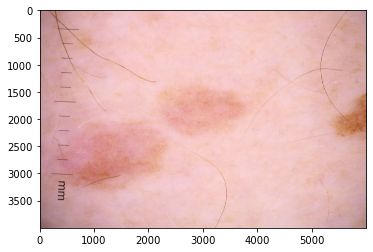

In [61]:
fnms = np.random.choice(dftst.im_pth, 50, replace=False)
for fnm in fnms:
    img = plt.imread(fnm)
    plt.imshow(img)
    plt.show()